# IPCV Assignment 1

Authors:

- Mauro Dore             - mauro.dore@studio.unibo.it            -
- Gian Mario Marongiu    - gianmario.marongiu@studio.unibo.it    - 0001092260
- Riccardo Murgia        - riccardo.murgia2@studio.unibo.it      - 0001083930

## Imports and Auxiliary Functions

In [1]:
import os
import cv2
import matplotlib.pyplot as plt
import math
import numpy as np
import random


In [2]:
def show_multiple_images(image_list, cols=3, titles=None, global_title=None, plot_height=3):
    if not image_list:
        raise ValueError("The image list must not be empty.")

    num_images = len(image_list)
    
    if titles and len(titles) != num_images:
        raise ValueError("Titles list length must match the number of images.")
    
    rows = -(-num_images // cols)  # Equivalent to math.ceil

    fig, axes = plt.subplots(rows, cols, figsize=(10, plot_height * rows))
    fig.subplots_adjust(top=0.9 if global_title else 1.0)
    
    if global_title:
        fig.suptitle(global_title, fontsize=16, fontweight='bold')
    
    axes = axes.flatten() if num_images > 1 else [axes]
    
    for i, ax in enumerate(axes):
        if i < num_images:
            ax.imshow(cv2.cvtColor(image_list[i], cv2.COLOR_BGR2RGB))
            ax.set_axis_off()
            if titles:
                ax.set_title(titles[i], fontsize=12, fontweight='bold')
        else:
            ax.set_visible(False)
    
    plt.tight_layout()
    plt.show()

    
def png_to_numpy(path, list):
    for image_name in os.listdir(path):
        image_path = os.path.join(path, image_name)
        image = cv2.imread(image_path)
        list.append(image)

def object_retrieve(model, scene, min_match_count=50):
    sift = cv2.SIFT_create()
    
    # Detect keypoints and compute descriptors
    kp_query, des_query = sift.detectAndCompute(model, None)
    kp_train, des_train = sift.detectAndCompute(scene, None)

    # FLANN parameters for matching
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    
    # Match descriptors using k-NN (k=2)
    matches = flann.knnMatch(des_query, des_train, k=2)
    
    # Lowe's ratio test to select good matches. m is first match, n is second match.
    good_matches = []
    for m, n in matches:
        if m.distance < 0.60 * n.distance:
            good_matches.append(m)
    
    if len(good_matches) > min_match_count:
        # Extract points from the good matches
        src_pts = np.float32([kp_query[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        dst_pts = np.float32([kp_train[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
        
        # Find homography matrix
        H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
        
        # Get the bounding box around the query image in the train image
        height, width = model.shape[:2]
        img_corners = np.float32([[0, 0], [0, height - 1], [width - 1, height - 1], [width - 1, 0]]).reshape(-1, 1, 2)
        dst = cv2.perspectiveTransform(img_corners, H)

        # Draw bounding box on the train image
        img_train_boxed = cv2.polylines(np.array(scene), [np.int32(dst)], True, (0, 255, 0), 5, cv2.LINE_AA)
        
        return True, img_train_boxed, len(good_matches)
    else:
        return False, scene, 0


def print_detection_summary(real_matchings, detected_matchings):
    for scene in real_matchings.keys():
        scene_str = f"Scene {scene}".ljust(20)
        present_models_str = f"Present Models: {real_matchings[scene]}".ljust(40)
        detected_models_str = f"Detected Models: {detected_matchings[scene]}"
    
        print(f"{scene_str} {present_models_str} {detected_models_str}")


In [3]:
MODELS_SINGLE_INSTANCE_PATH = "models_single_instance"
SCENES_SINGLE_INSTANCE_PATH = "scenes_single_instance"
MODELS_MULTIPLE_INSTANCES_PATH = "models_multiple_instances"
SCENES_MULTIPLE_INSTANCES_PATH = "scenes_multiple_instances"

models_single_instance = []
scenes_single_instance = []
models_multiple_instances = []
scenes_multiple_instances = []

png_to_numpy(MODELS_SINGLE_INSTANCE_PATH, models_single_instance)
png_to_numpy(SCENES_SINGLE_INSTANCE_PATH, scenes_single_instance)
png_to_numpy(MODELS_MULTIPLE_INSTANCES_PATH, models_multiple_instances)
png_to_numpy(SCENES_MULTIPLE_INSTANCES_PATH, scenes_multiple_instances)
    
print(f"{len(models_single_instance)} models and {len(scenes_single_instance)} scenes for single instance detection task")
print(f"{len(models_multiple_instances)} models and {len(scenes_multiple_instances)} scenes for multiple instances detection task")


14 models and 5 scenes for single instance detection task
13 models and 7 scenes for multiple instances detection task


## Task Analysis

The objective is to perform instance detection using the provided model images. Several challenges must be addressed:

- The scenes contain significant noise, which must be mitigated prior to detection;
- The models are noticeably brighter than the scenes, indicating the need for a method that is robust to intensity variations;
- The models and scenes exhibit considerable variation in shape, necessitating the use of a scale-invariant detector.

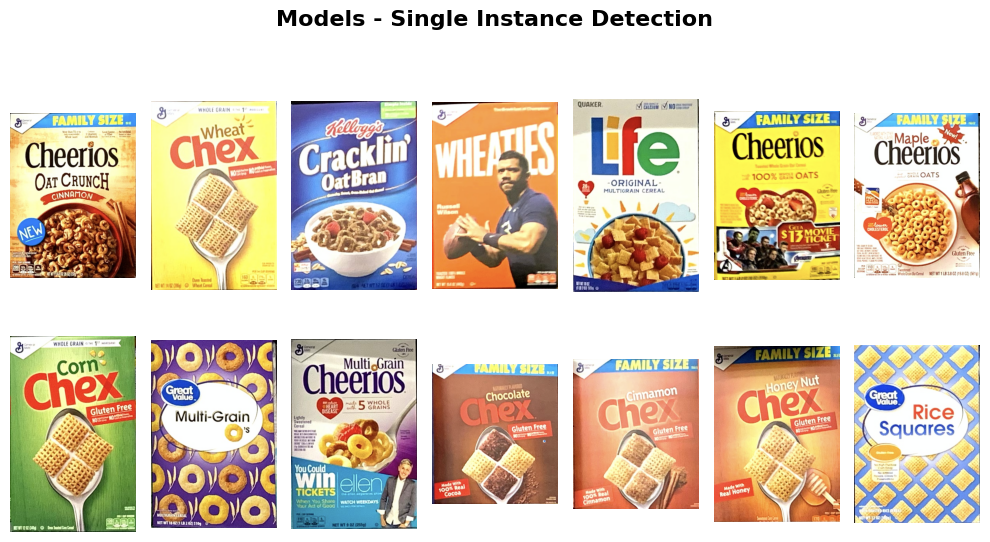

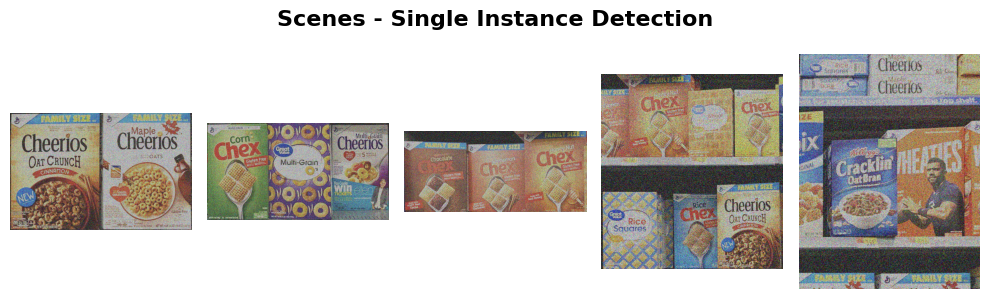

In [4]:
single_instance_real_matchings = {0: [0, 6], 1: [7, 8, 9], 2: [10, 11, 12], 3: [11, 12, 13, 1, 0], 4: [2, 3]}
show_multiple_images(models_single_instance, cols=7, global_title="Models - Single Instance Detection")
show_multiple_images(scenes_single_instance, cols=5, global_title="Scenes - Single Instance Detection")


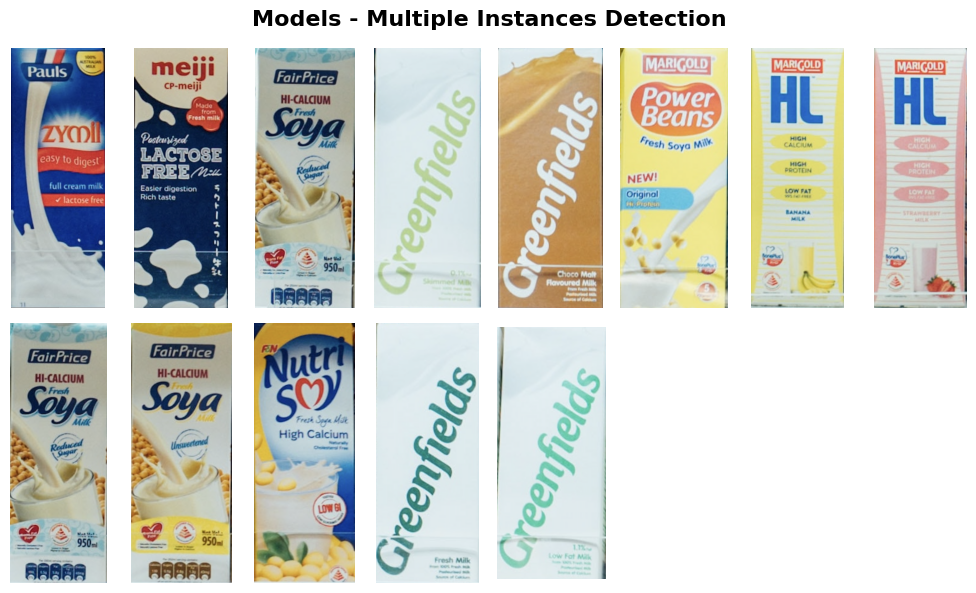

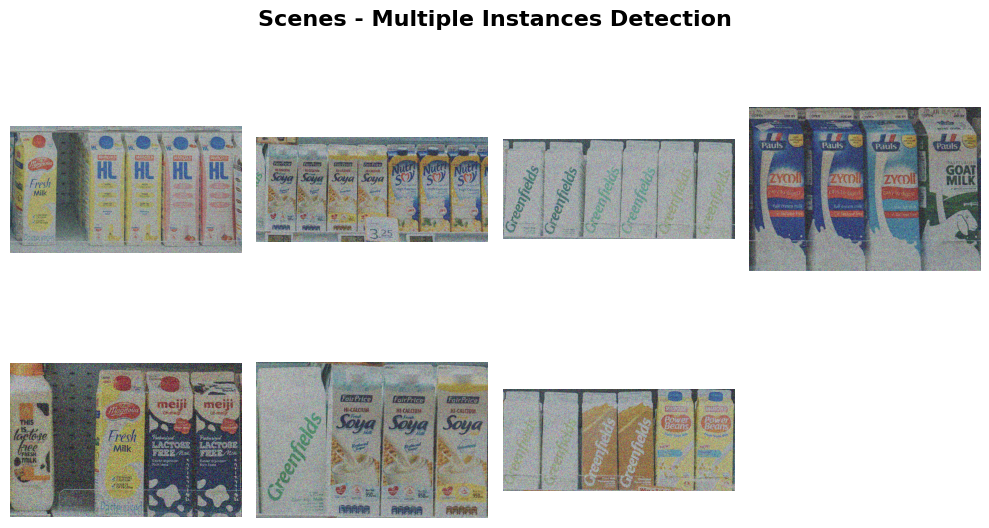

In [5]:
show_multiple_images(models_multiple_instances, cols=8, global_title="Models - Multiple Instances Detection")
show_multiple_images(scenes_multiple_instances, cols=4, global_title="Scenes - Multiple Instances Detection")


## Scenes Denoising

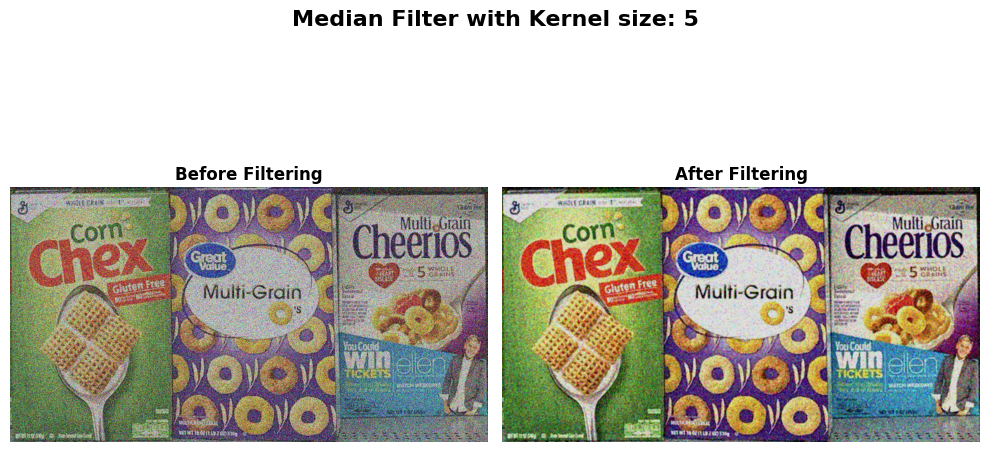

In [12]:
denoised_scenes_single_instance = []
denoised_scenes_multiple_instances = []
kernel_size = 5

for scene in scenes_single_instance:
    denoised_scene = cv2.medianBlur(scene, kernel_size)
    denoised_scenes_single_instance.append(denoised_scene)
    
for scene in scenes_multiple_instances:
    denoised_scene = cv2.medianBlur(scene, kernel_size)
    denoised_scenes_multiple_instances.append(denoised_scene)

# example of denoised image
random_idx = np.random.randint(len(scenes_single_instance))
show_multiple_images([scenes_single_instance[random_idx], denoised_scenes_single_instance[random_idx]], 
                     global_title=f"Median Filter with Kernel size: {kernel_size}", 
                     titles=["Before Filtering", "After Filtering"], 
                     cols=2,
                     plot_height=6)


In [7]:
# todo: provare a inserire una seconda fase di denoising oppure sostituire completamente median filter con NLM filter. Bisogna testare. Qua sotto provavo a vedere se NLM riusciva a togliere un po' di quel rumorino che si è lasciato dietro il median.

"""esempio = denoised_scenes_single_instance[random_idx]
denoised_esempio = cv2.fastNlMeansDenoisingColored(esempio, None, 10, 10, 7, 15) 

# Display the original and denoised image
show_multiple_images([esempio, denoised_esempio], 
                     global_title="Non-Local Means Denoising", 
                     titles=["Before Filtering", "After Filtering"], 
                     cols=2,
                     plot_height=8)""";

## Single Instance Detection

In [8]:
# todo: detectare tutto. Idea by Gian: Usiamo un feature extractor tipo DoG con descriptor SIFT che dovrebbe essere abbastanza invariante ai cambi in illuminazione. Poi con le feature estratte creiamo lo star model per fare l'effettiva detection.

# todo: smanettare con il denoising per fare matching con tutti
# todo: refactoring del codice
# todo: verificare FLANN che fa e come funziona

In [9]:
model_scene_couples = []
single_instance_detected_matchings = {scene: [] for scene in range(len(scenes_single_instance))}
min_match_count = 55

for model_idx, model in enumerate(models_single_instance):
    for scene_idx, scene in enumerate(denoised_scenes_single_instance):
        found, scene_boxed, good_matches = object_retrieve(model, scene, min_match_count)
        model_scene_couples.append([model, scene_boxed, found, good_matches])
        
        if found:
            single_instance_detected_matchings[scene_idx].append(model_idx)            

print_detection_summary(single_instance_real_matchings, single_instance_detected_matchings)
    

Scene 0              Present Models: [0, 6]                   Detected Models: [0, 6]
Scene 1              Present Models: [7, 8, 9]                Detected Models: [6, 7, 8, 9]
Scene 2              Present Models: [10, 11, 12]             Detected Models: [10, 11, 12]
Scene 3              Present Models: [11, 12, 13, 1, 0]       Detected Models: [0]
Scene 4              Present Models: [2, 3]                   Detected Models: [2, 3]


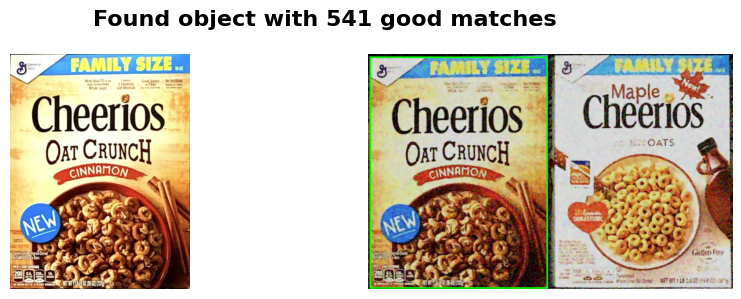

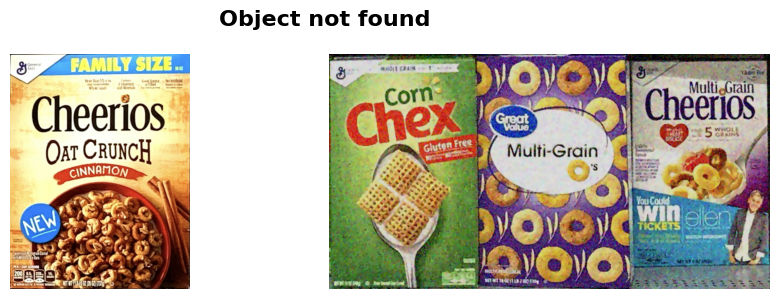

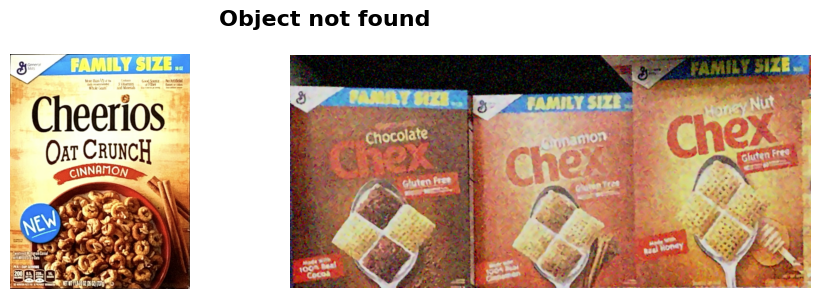

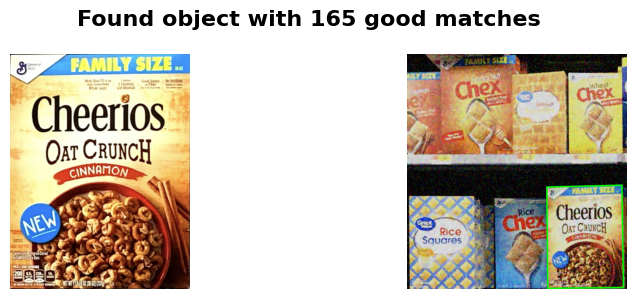

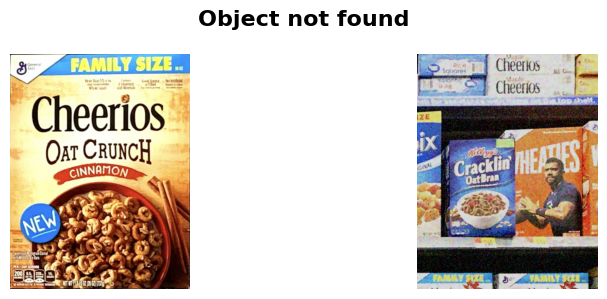

...

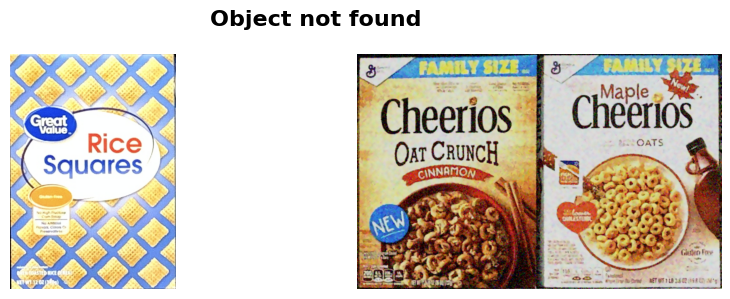

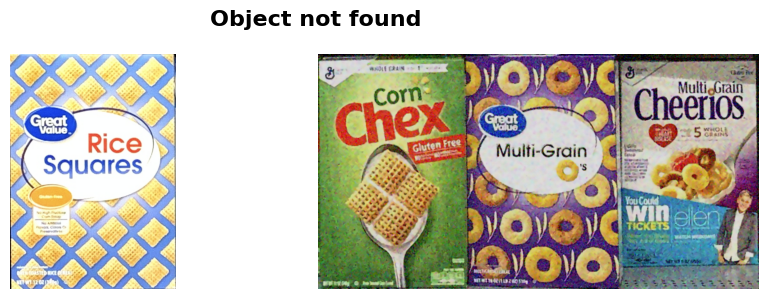

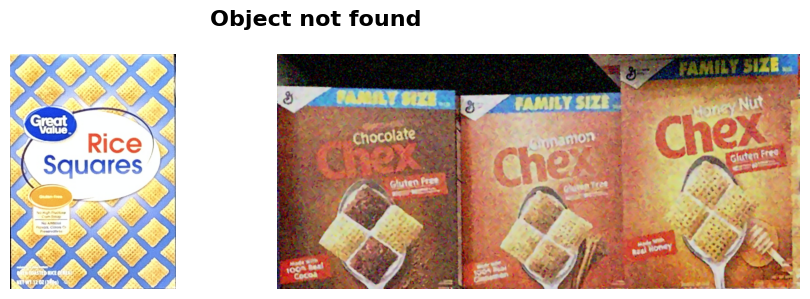

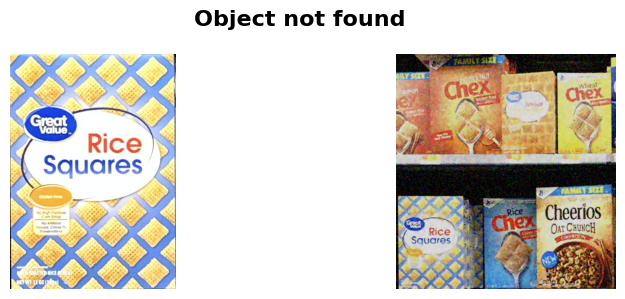

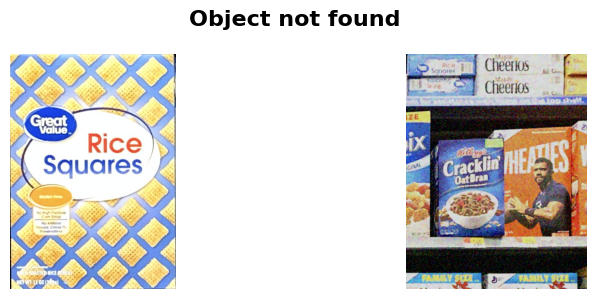

In [10]:
for model, scene, found, good_matches in model_scene_couples:
    if found > 0:
        show_multiple_images([model, scene], cols=2, global_title=f"Found object with {good_matches} good matches")
    else:
        show_multiple_images([model, scene], cols=2, global_title="Object not found")

## Multiple Instances Detection

In [11]:
#todo: tuttoooooo